In [1]:
%load_ext autoreload
%autoreload 2

import pandas as pd
import numpy as np 
from matplotlib import pyplot as plt 
import seaborn as sbn 

import statsmodels.api as sm
from sklearn.preprocessing import OneHotEncoder

%aimport HER2_classifier

In [2]:
class myspace(object): 
    def __init__(self): 
        pass

args                    =       myspace()
args.data               =       ['./HER2_SKBR3_data_6-7-21/']
args.out                =       ['./output/'] 
args.drug               =       ['Neratinib']  # ['Trastuzumab']
args.sensitive_line     =       ['WT']
args.resistant_line     =       ['T798I']  #['ND611'] #['T798I']       # ['ND611]
args.load               =       ['normalized']  # ['raw']
args.nclus              =       [15]
args.resample_sz        =       [125]
args.burnin             =       [0]

--- 
---
# Load Data 
---
---

In [3]:
data, clover_sel, mscarl_sel = HER2_classifier.load_data(args)
print('len selector:', len(clover_sel))
print(clover_sel[0:5])
print(mscarl_sel[0:5])
data.head()


loading data...
# of datasets to load: 13
mapping drug names to one name...
len selector: 135
['0_x', '15_x', '30_x', '45_x', '60_x']
['0_y', '15_y', '30_y', '45_y', '60_y']


,track_index,0_x,15_x,30_x,45_x,60_x,75_x,90_x,105_x,120_x,...,2805_y,2820_y,2835_y,2850_y,2865_y,2880_y,2895_y,drug,cell_line,mutant
0,3_1000011860_skbr3_erk_akt__WT_untreated,0.836900,0.838897,0.557456,0.852664,1.137005,0.798656,0.696818,0.596282,0.495039,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,untreated,SKBR3,WT
1,79_1000288819_skbr3_erk_akt__WT_untreated,0.615120,0.775863,0.840381,0.828898,0.797149,0.827444,0.779779,0.848228,0.868804,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,untreated,SKBR3,WT
2,78_1000285319_skbr3_erk_akt__WT_untreated,0.790633,0.865733,0.793790,0.890870,0.870234,0.917848,0.700682,1.004571,0.972406,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,untreated,SKBR3,WT
3,78_1000282488_skbr3_erk_akt__WT_untreated,0.919838,0.836807,0.853458,0.712794,0.662686,0.630794,0.635830,0.723558,0.749466,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,untreated,SKBR3,WT
4,1_1000002701_skbr3_erk_akt__WT_untreated,0.822612,0.834595,0.920568,0.968030,0.896872,0.906976,0.933929,0.925297,0.913278,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,untreated,SKBR3,WT


In [4]:
data.drug.unique()

array(['untreated', '10nm_neratinib', '10ug_ml_trastuzumab'], dtype=object)

In [5]:
data.cell_line.unique()

array(['SKBR3'], dtype=object)

In [6]:
data.mutant.unique()

array(['WT', 'T798I', 'ND611', 'ND648', 'S310Y', 'T306M', 'L313V',
       'T733I', 'L755T759DEL', 'I767M', 'A355QFS76', 'D639E', 'Y835F',
       'V842I', 'R678Q', 'V424I', 'D769Y', 'E717K', 'E744D', 'G621AFS31',
       'I435L', 'I886M', 'L43V', 'P416T', 'P702L', 'R203P', 'R340G',
       'R456C', 'R47C', 'S609C', 'T479M', 'W906C', 'Y64F', 'D277H',
       'D638H', 'D873G', 'G1055C', 'G778S779INSLPS', 'H470Q', 'H878Y',
       'L662V', 'M833I', 'L785F', 'L869R', 'P122L', 'S305C', 'W482GFS74',
       'E939G', 'G727A', 'M889I', 'N488S', 'Q1206K', 'W825', 'A1039T',
       'E975Q', 'S310F', 'R34W', 'R929WL', 'S963', 'V797A',
       'Y722V773INSRDGE', 'L1197F', 'R1153L', 'Y1127A1129DEL', 'R897G',
       'P523S', 'D769N', 'E770A771INSGIRD', 'N427K', 'P232S', 'R190Q',
       'A1160V', 'T297I', 'T862S', 'V697L', 'P579L', 'R288Q', 'A37T',
       'D933Y', 'E405D', 'F976L', 'L755S'], dtype=object)

--- 
---
# Filter NA 
---
---

In [7]:
data, low_data_flags, clover_sel, mscarl_sel = HER2_classifier.filter_na(data, args, clover_sel, mscarl_sel)
print('len selector:', len(clover_sel))
print(clover_sel[0:5])
print(mscarl_sel[0:5])
data.head()


filtering to drug and removing NAs...
Data shape (untreated + drug): (23672, 398)
length of time series BEFORE removing time points with NA 135
length of time series AFTER removing time points with NA 135
len selector: 135
['0_x' '15_x' '30_x' '45_x' '60_x']
['0_y' '15_y' '30_y' '45_y' '60_y']


,track_index,0_x,15_x,30_x,45_x,60_x,75_x,90_x,105_x,120_x,...,2805_y,2820_y,2835_y,2850_y,2865_y,2880_y,2895_y,drug,cell_line,mutant
0,3_1000011860_skbr3_erk_akt__WT_untreated,0.836900,0.838897,0.557456,0.852664,1.137005,0.798656,0.696818,0.596282,0.495039,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,untreated,SKBR3,WT
1,79_1000288819_skbr3_erk_akt__WT_untreated,0.615120,0.775863,0.840381,0.828898,0.797149,0.827444,0.779779,0.848228,0.868804,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,untreated,SKBR3,WT
2,78_1000285319_skbr3_erk_akt__WT_untreated,0.790633,0.865733,0.793790,0.890870,0.870234,0.917848,0.700682,1.004571,0.972406,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,untreated,SKBR3,WT
3,78_1000282488_skbr3_erk_akt__WT_untreated,0.919838,0.836807,0.853458,0.712794,0.662686,0.630794,0.635830,0.723558,0.749466,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,untreated,SKBR3,WT
4,1_1000002701_skbr3_erk_akt__WT_untreated,0.822612,0.834595,0.920568,0.968030,0.896872,0.906976,0.933929,0.925297,0.913278,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,untreated,SKBR3,WT


In [8]:
low_data_flags

,mutant,drug,cell_track_count,low_data_flag
0,A1039T,neratinib,125,False
1,A1039T,untreated,96,False
2,A1160V,neratinib,109,False
3,A1160V,untreated,68,False
4,A355QFS76,neratinib,134,False
...,...,...,...,...
159,Y64F,untreated,144,False
160,Y722V773INSRDGE,neratinib,58,False
161,Y722V773INSRDGE,untreated,60,False
162,Y835F,neratinib,126,False


(array([150.,   8.,   0.,   0.,   1.,   0.,   2.,   2.,   0.,   1.]),
 array([  17. ,  195.3,  373.6,  551.9,  730.2,  908.5, 1086.8, 1265.1,
        1443.4, 1621.7, 1800. ]),
 <BarContainer object of 10 artists>)

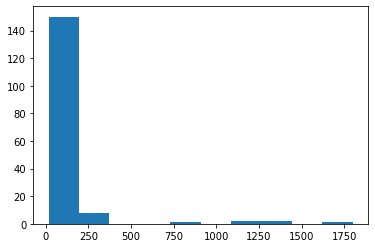

In [9]:
plt.hist(low_data_flags.cell_track_count)

--- 
---
# Add `Burn-in`  

Remove the first few time points  

---
---

In [10]:
clover_sel, mscarl_sel = HER2_classifier.burnin(args, clover_sel, mscarl_sel)
print('len selector:', len(clover_sel))
print('len selector:', len(mscarl_sel))
print(clover_sel[0:5])
print(mscarl_sel[0:5])

adding burnin of 0
len selector: 135
len selector: 135
['0_x' '15_x' '30_x' '45_x' '60_x']
['0_y' '15_y' '30_y' '45_y' '60_y']


--- 
---
# Resample time-series
---
---

In [11]:
X_train = HER2_classifier.resample(data, args, clover_sel, mscarl_sel)


resampling time series...
Training data shape BEFORE resampling: (23672, 135, 2)
Training data shape AFTER resampling: (23672, 125, 2)


--- 
---
# Fit the time-series K-means clustering
---
---


performing time-series kmeans clustering...

5.551 --> 3.966 --> 3.875 --> 3.832 --> 3.806 --> 3.788 --> 3.773 --> 3.761 --> 3.753 --> 3.746 --> 3.740 --> 3.736 --> 3.733 --> 3.731 --> 3.728 --> 3.726 --> 3.725 --> 3.723 --> 3.722 --> 3.721 --> 3.720 --> 3.719 --> 3.718 --> 3.717 --> 3.716 --> 3.715 --> 3.715 --> 3.714 --> 3.713 --> 3.712 --> 3.711 --> 3.710 --> 3.709 --> 3.709 --> 3.708 --> 3.708 --> 3.707 --> 3.707 --> 3.707 --> 3.706 --> 3.706 --> 3.706 --> 3.706 --> 3.706 --> 3.706 --> 3.706 --> 3.705 --> 3.705 --> 3.705 --> 3.705 --> 



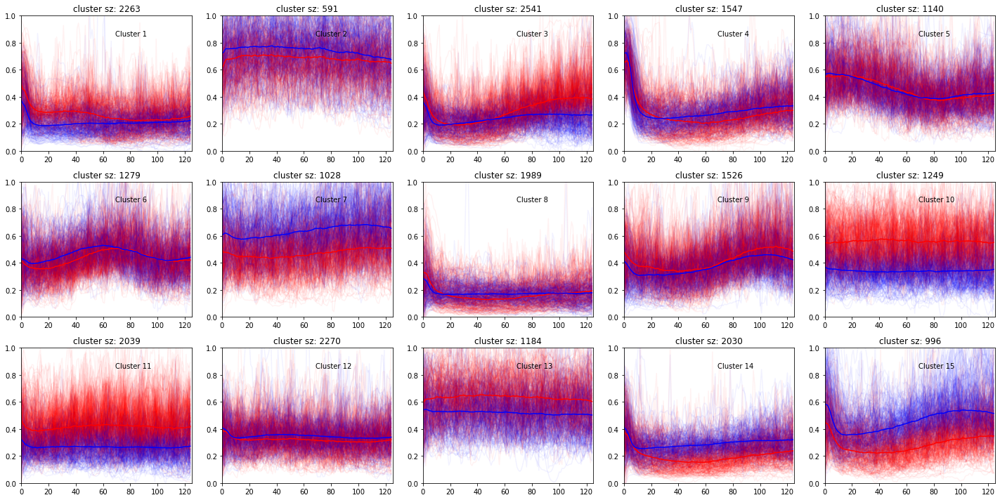

In [12]:
y_pred, km = HER2_classifier.fit_timeseries_kmeans(args, X_train, plot=True, save=None)

--- 
---
# Calculate the cluster proportion 

...within each experiment. 

---
---

In [13]:
cm, lb = HER2_classifier.quantify_cluster_prop(args, data, y_pred)
cm.shape


quantifying experiment by cluster proportions...


(252, 15)

--- 
---
# Visualize the cluster co-occurence within experiment
---
---

<Figure size 504x504 with 0 Axes>

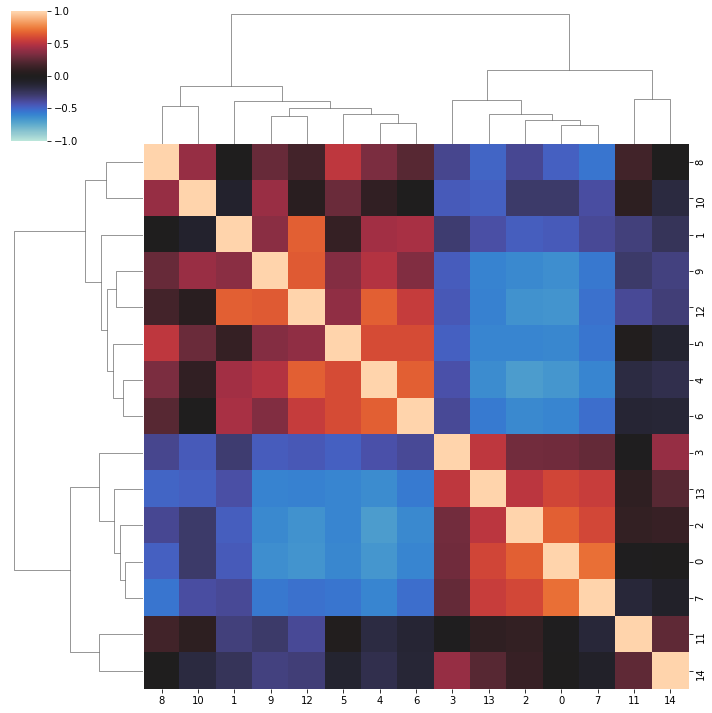

In [14]:
HER2_classifier.plot_cluster_corr(cm, save=None)

--- 
---
# Plot hiearchichal clustering of cluster membership 
---
---

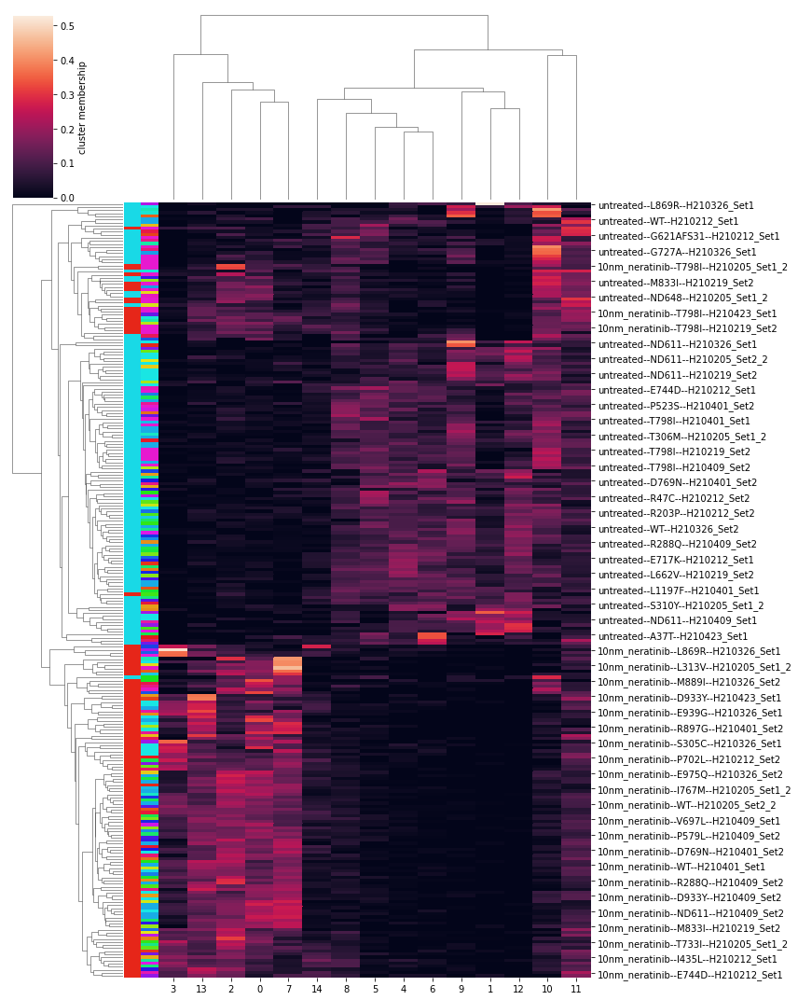

In [15]:
HER2_classifier.plot_cluster_heatmap(cm, lb, save=None)

--- 
---
# Dimensionality Reduction 
---
---


performing dim. reduction (pca)...
PCA explained variance ratio: [0.49742903 0.12803451]
PC shape: (252, 2)


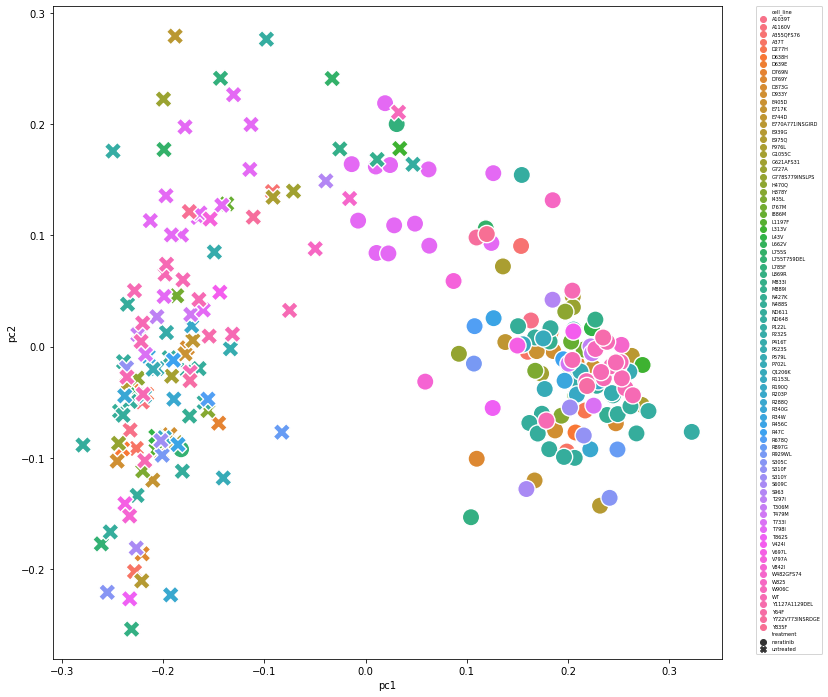

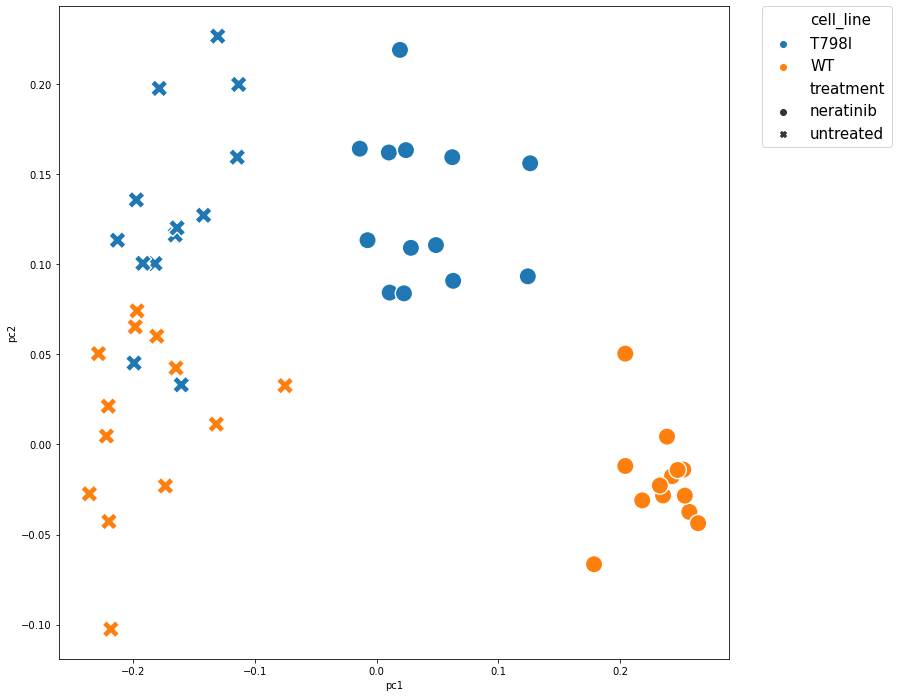

In [16]:
res, pca = HER2_classifier.reduce_dim(args, cm, lb, plot=True, save=None)

In [17]:
res

,pc1,pc2,treatment,cell_line,exp_set
0,0.163363,0.023538,neratinib,A1039T,H210326_Set2
1,0.235131,-0.030598,neratinib,A1160V,H210409_Set1
2,0.153608,0.090526,neratinib,A355QFS76,H210205_Set2_2
3,0.160059,-0.004626,neratinib,A37T,H210409_Set2
4,0.198847,-0.094318,neratinib,A37T,H210423_Set1
...,...,...,...,...,...
247,-0.131653,0.011243,untreated,WT,H210423_Set1
248,-0.154647,0.009454,untreated,Y1127A1129DEL,H210401_Set2
249,-0.173571,-0.030475,untreated,Y64F,H210219_Set1
250,-0.111031,0.116477,untreated,Y722V773INSRDGE,H210401_Set1


In [18]:
pc_loadings = pd.DataFrame({'clus_feat': range(pca.components_.shape[1]), 'PC1':pca.components_[0], 'PC2':pca.components_[1]})
pc_loadings.head()

,clus_feat,PC1,PC2
0,0,0.361643,0.087025
1,1,-0.178092,-0.336342
2,2,0.360173,0.152652
3,3,0.238122,-0.246357
4,4,-0.221515,-0.141205


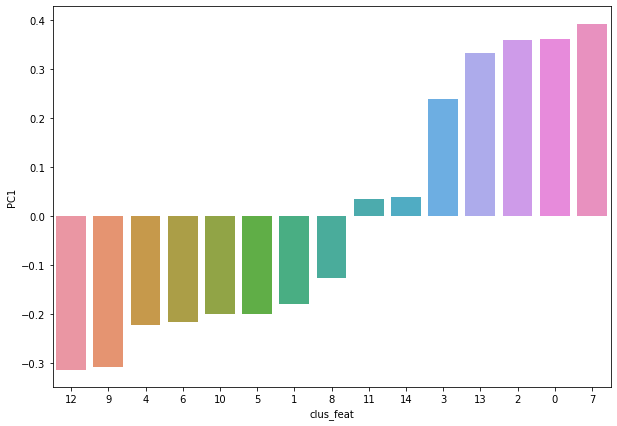

In [19]:
plt.figure(figsize=(10,7))
sbn.barplot(x='clus_feat', y='PC1', data=pc_loadings, order=pc_loadings.sort_values(by='PC1').clus_feat)
plt.show()

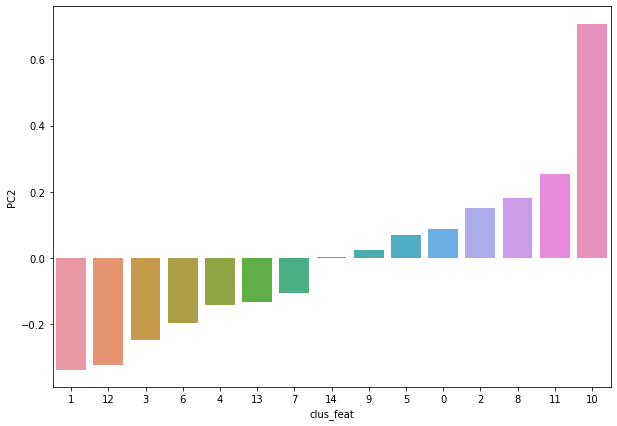

In [20]:
plt.figure(figsize=(10,7))
sbn.barplot(x='clus_feat', y='PC2', data=pc_loadings, order=pc_loadings.sort_values(by='PC2').clus_feat)
plt.show()

In [21]:
res

,pc1,pc2,treatment,cell_line,exp_set
0,0.163363,0.023538,neratinib,A1039T,H210326_Set2
1,0.235131,-0.030598,neratinib,A1160V,H210409_Set1
2,0.153608,0.090526,neratinib,A355QFS76,H210205_Set2_2
3,0.160059,-0.004626,neratinib,A37T,H210409_Set2
4,0.198847,-0.094318,neratinib,A37T,H210423_Set1
...,...,...,...,...,...
247,-0.131653,0.011243,untreated,WT,H210423_Set1
248,-0.154647,0.009454,untreated,Y1127A1129DEL,H210401_Set2
249,-0.173571,-0.030475,untreated,Y64F,H210219_Set1
250,-0.111031,0.116477,untreated,Y722V773INSRDGE,H210401_Set1


---
---
# Check for Batch Effects
---
---

['H210326_Set2' 'H210409_Set1' 'H210205_Set2_2' 'H210409_Set2'
 'H210423_Set1' 'H210219_Set1' 'H210401_Set2' 'H210212_Set1'
 'H210219_Set2' 'H210326_Set1' 'H210205_Set1_2' 'H210401_Set1'
 'H210212_Set2']
['H210205_Set1_2', 'H210205_Set2_2', 'H210212_Set1', 'H210212_Set2', 'H210219_Set1', 'H210219_Set2', 'H210326_Set1', 'H210326_Set2', 'H210401_Set1', 'H210401_Set2', 'H210409_Set1', 'H210409_Set2', 'H210423_Set1', 'neratinib', 'untreated', 'T798I', 'WT']
feature order:
	 x1  ->  H210205_Set1_2
	 x2  ->  H210205_Set2_2
	 x3  ->  H210212_Set1
	 x4  ->  H210212_Set2
	 x5  ->  H210219_Set1
	 x6  ->  H210219_Set2
	 x7  ->  H210326_Set1
	 x8  ->  H210326_Set2
	 x9  ->  H210401_Set1
	 x10  ->  H210401_Set2
	 x11  ->  H210409_Set1
	 x12  ->  H210409_Set2
	 x13  ->  H210423_Set1
	 x14  ->  neratinib
	 x15  ->  untreated
	 x16  ->  T798I
	 x17  ->  WT
---------------------------------------------------------------------------
PC1 ANOVA
-------------------------------------------------------------

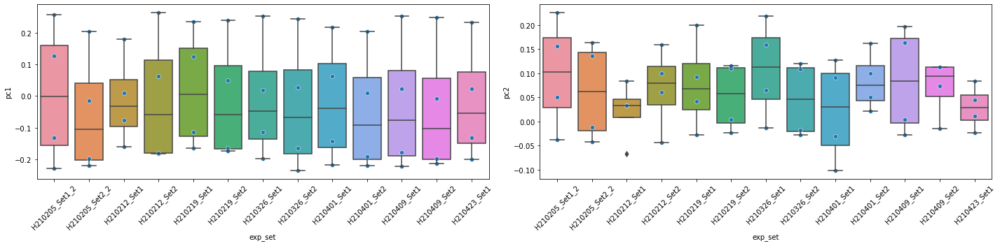

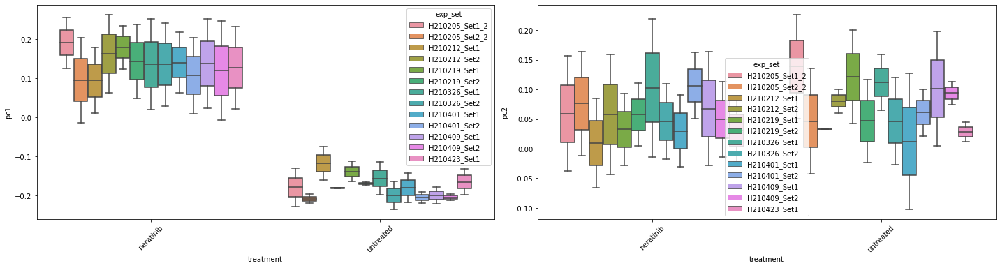

,constant,H210205_Set1_2,H210205_Set2_2,H210212_Set1,H210212_Set2,H210219_Set1,H210219_Set2,H210326_Set1,H210326_Set2,H210401_Set1,H210401_Set2,H210409_Set1,H210409_Set2,H210423_Set1,neratinib,untreated,T798I,WT,PC
0,5.039888e-02,0.468141,0.303348,0.815706,0.761831,0.261693,0.845074,0.790058,0.727701,0.999608,0.406112,0.758169,0.525919,0.979397,7.488417e-17,9.978920e-18,6.404944e-05,1.040380e-03,1
1,4.738026e-13,0.067941,0.985576,0.054850,0.689838,0.436767,0.662806,0.027012,0.467037,0.056182,0.269942,0.254593,0.598015,0.126767,2.094621e-01,5.201694e-04,4.587270e-16,2.240230e-10,2


In [22]:
batch_res = HER2_classifier.check_batch_effects(args, res, plot=True, save=None)
batch_res.head()

--- 
---
# Train classifier on `[positive/negative]` controls
---
---


training classifier...
sensitive line: 	 WT
resistant line: 	 T798I
drug:		 neratinib
drug + WT df size:  (26, 5)
X train shape: (26, 2)
# neg class (resistant): 13
# pos class (sensitive): 13


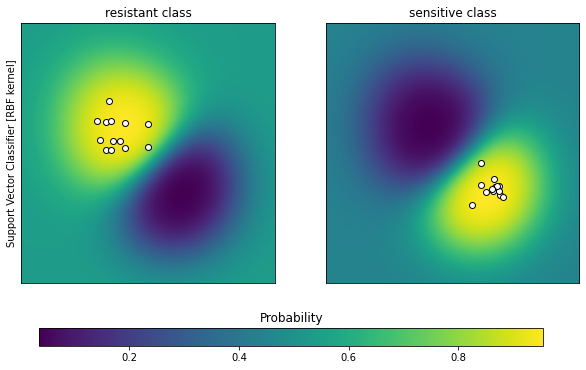

In [23]:
model, accuracy = HER2_classifier.train_classifier(args, res, plot=True, save=None)

--- 
---
# Assign mutant sensitivity/resistance calls
---
---

In [24]:
prob_res = HER2_classifier.predict_mutants(args, model, res, batch_res, low_data_flags)
prob_res


predicting unlabeled sensitivities...


,pc1,pc2,treatment,exp_set,prob_res,prob_sens,call,odds_ratio,batch,PC1_batch_pval,PC1_batch_flag,PC2_batch_pval,PC2_batch_flag,mutant,drug,cell_track_count,low_data_flag
0,0.218769,-0.035373,neratinib,H210219_Set1,0.045853,0.954147,sens,0.048057,H210219_Set1,0.261693,False,0.436767,False,Y64F,neratinib,189,False
1,0.228407,-0.035183,neratinib,H210423_Set1,0.045889,0.954111,sens,0.048096,H210423_Set1,0.979397,False,0.126767,False,ND611,neratinib,1159,False
2,0.227693,-0.030819,neratinib,H210423_Set1,0.046224,0.953776,sens,0.048464,H210423_Set1,0.979397,False,0.126767,False,L755S,neratinib,134,False
3,0.229810,-0.031248,neratinib,H210212_Set2,0.046314,0.953686,sens,0.048563,H210212_Set2,0.761831,False,0.689838,False,R203P,neratinib,52,False
4,0.208795,-0.043061,neratinib,H210409_Set1,0.046691,0.953309,sens,0.048978,H210409_Set1,0.758169,False,0.254593,False,R190Q,neratinib,97,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,0.154296,0.154371,neratinib,H210205_Set2_2,0.876945,0.123055,res,7.126455,H210205_Set2_2,0.303348,False,0.985576,False,ND648,neratinib,142,False
96,0.119726,0.101258,neratinib,H210205_Set2_2,0.887475,0.112525,res,7.886944,H210205_Set2_2,0.303348,False,0.985576,False,Y835F,neratinib,126,False
97,0.118732,0.106273,neratinib,H210409_Set2,0.899202,0.100798,res,8.920860,H210409_Set2,0.525919,False,0.598015,False,L755S,neratinib,134,False
98,0.109616,0.098131,neratinib,H210401_Set1,0.903012,0.096988,res,9.310560,H210401_Set1,0.999608,False,0.056182,False,Y722V773INSRDGE,neratinib,58,False


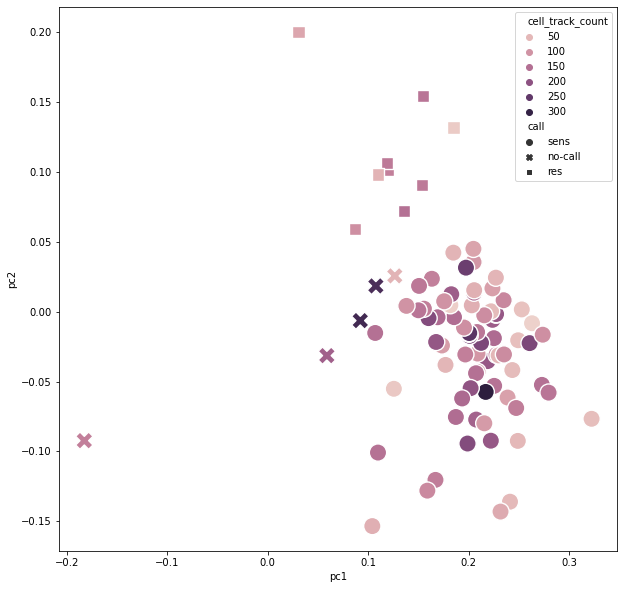

In [25]:
plt.figure(figsize=(10,10))
sbn.scatterplot(x='pc1', y='pc2', data=prob_res[lambda x: ~x.mutant.isin(['WT', 'ND611', 'T798I'])], hue='cell_track_count', style='call', s=300)
plt.show()

In [26]:
prob_res.sort_values('cell_track_count')

,pc1,pc2,treatment,exp_set,prob_res,prob_sens,call,odds_ratio,batch,PC1_batch_pval,PC1_batch_flag,PC2_batch_pval,PC2_batch_flag,mutant,drug,cell_track_count,low_data_flag
36,0.263019,-0.008288,neratinib,H210401_Set2,0.061821,0.938179,sens,0.065895,H210401_Set2,0.406112,False,0.269942,False,E770A771INSGIRD,neratinib,17,False
61,0.181766,0.004668,neratinib,H210326_Set2,0.102178,0.897822,sens,0.113806,H210326_Set2,0.727701,False,0.467037,False,M889I,neratinib,21,False
92,0.184864,0.131663,neratinib,H210326_Set2,0.712781,0.287219,res,2.481665,H210326_Set2,0.727701,False,0.467037,False,W825,neratinib,25,False
74,0.125557,-0.055160,neratinib,H210409_Set1,0.149472,0.850528,sens,0.175741,H210409_Set1,0.758169,False,0.254593,False,T862S,neratinib,29,False
34,0.252820,0.001605,neratinib,H210326_Set1,0.061145,0.938855,sens,0.065128,H210326_Set1,0.790058,False,0.027012,True,W482GFS74,neratinib,37,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55,0.267647,-0.078004,neratinib,H210205_Set1_2,0.081200,0.918800,sens,0.088377,H210205_Set1_2,0.468141,False,0.067941,False,ND611,neratinib,1159,False
66,0.182649,0.016553,neratinib,H210409_Set1,0.126275,0.873725,sens,0.144525,H210409_Set1,0.758169,False,0.254593,False,ND611,neratinib,1159,False
23,0.249137,-0.060615,neratinib,H210326_Set1,0.056254,0.943746,sens,0.059607,H210326_Set1,0.790058,False,0.027012,True,ND611,neratinib,1159,False
46,0.181427,-0.092211,neratinib,H210212_Set1,0.070435,0.929565,sens,0.075772,H210212_Set1,0.815706,False,0.054850,False,ND611,neratinib,1159,False
